In [46]:
# Reload the notebook automatically
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Import

In [47]:
import sys
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
import cv2
from IPython.display import clear_output

WORK_DIR = Path(Path.cwd()).parent
sys.path.append(str(WORK_DIR))
from src import ROOT, parse
from src.models import get_model
from src.datasets.transforms import *
from src.datasets import get_dataset, get_dataloader
from src.utils import *

cfg_dir = 'mlcv-exp/data/cfg/'

# Model

In [48]:
dataset = 'fpha'
model_name = 'hpo_bbox_ar_SL'
exp = 'exp1'
epoch = 200
cfg_name = '{}_{}_{}.cfg'.format(dataset, model_name, exp)
cfg = parse(Path(ROOT)/cfg_dir/model_name/cfg_name)

model = get_model(cfg, 'train', epoch)

val dataset: 100%|██████████| 575/575 [00:09<00:00, 57.89it/s]


In [50]:
model.net.eval()
# model.net.train()
clear_output()

In [51]:
func = abs_sum_p(2)
# func = abs_sum
# func = abs_mean
# func = max_sum_p(2)

# Spatial Attention Map

In [52]:
# img_path = Path('EPIC_KITCHENS_2018')/'EK_frames'/'P03/P03_10_7118_open_juice'/'img_{:05d}.jpg'.format(0)
# img_path = Path('EPIC_KITCHENS_2018')/'EK_frames'/'P03/P03_10_7118_open_juice'/'img_{:05d}.jpg'.format(100)
# img_path = Path('EPIC_KITCHENS_2018')/'EK_frames'/'P01/P01_03_502_put-down_milk'/'img_{:05d}.jpg'.format(0)
# img_path = Path('EPIC_KITCHENS_2018')/'EK_frames'/'P20/P20_03_21943_open_drawer'/'img_{:05d}.jpg'.format(0)
# img_path = Path(ROOT)/'EPIC_KITCHENS_2018'/'EK_frames'/'P02/P02_09_5236_pour_salt'/'img_{:05d}.jpg'.format(0)
# img_path = '/4TB/aaron/EPIC_KITCHENS_2018/EK_frames/P29/P29_04_35766_search-for_scissors/img_00162.jpg'

In [53]:
# img_path = Path('First_Person_Action_Benchmark')/'Video_files_rsz'/'Subject_1/open_juice_bottle/1/color/color_0009.jpeg' 
# img_path = Path('First_Person_Action_Benchmark')/'Video_files_rsz'/'Subject_4/tear_paper/1/color/color_0133.jpeg'
# img_path = '/4TB/aaron/First_Person_Action_Benchmark/Video_files_rsz/Subject_1/open_juice_bottle/1/color/color_0002.jpeg'

In [ ]:
img = get_img_dataloader(str(Path(ROOT)/img_path), 416)
img = img.unsqueeze(0).cuda()
spatial_attn_map = model.net.get_spatial_attn_map(img)
proc_attn_map = [[x[0].detach().cpu().numpy() for x in block] for block in spatial_attn_map]
proc_attn_map = [[func(x) for x in block] for block in proc_attn_map]

img = ImgToNumpy()(img.cpu())[0]
fig, ax = plt.subplots()
ax.imshow(img)
plt.show()

# Overlay

layer 0


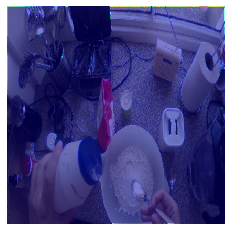

layer 1


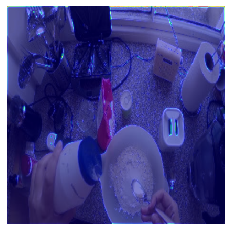

layer 2


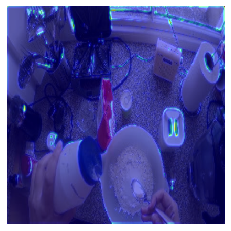

layer 3


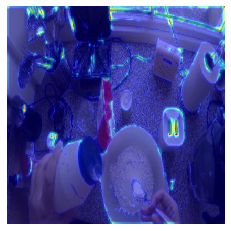

layer 4


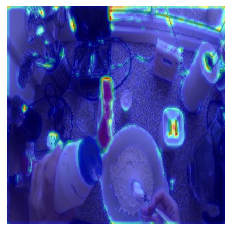

layer 5


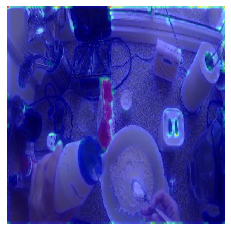

layer 6


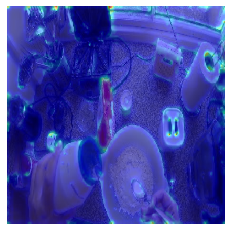

layer 7


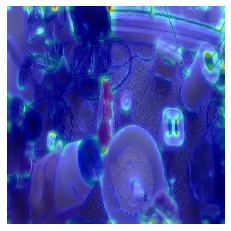

layer 8


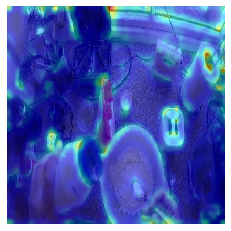

layer 9


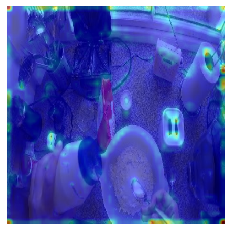

layer 10


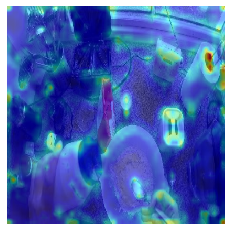

layer 11


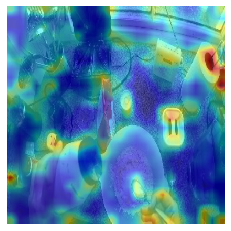

layer 12


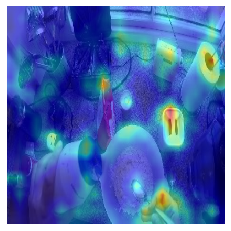

layer 13


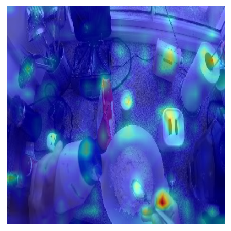

layer 14


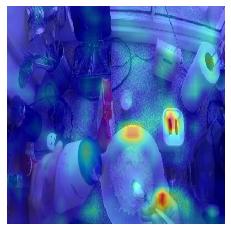

layer 15


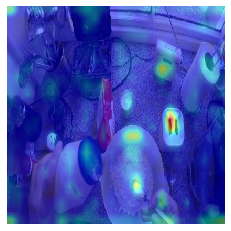

layer 16


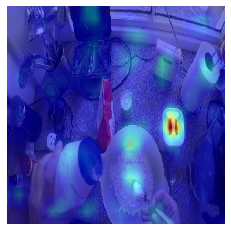

In [19]:
idx = 0
block = proc_attn_map[idx]
for i in range(len(block)):
    print('layer', i)
    fig, ax = plt.subplots()
    block_rsz = cv2.resize(block[i][:, :, np.newaxis], img.shape[:2])
    ax.imshow(block_rsz, cmap='jet')
    ax.imshow(img, alpha=0.5)
    plt.axis('off')
    plt.show()

# Raw

In [ ]:
# idx = 4
# block = proc_attn_map[idx]
# for i in range(len(block)):
#     fig, ax = plt.subplots()
#     ax.imshow(block[i], cmap='jet')
#     plt.show()

# Video

In [57]:
seq_name = 'P20/P20_03_21943_open_drawer'
# seq_name = 'P03/P03_10_7118_open_juice'
# seq_name = 'P01/P01_03_502_put-down_milk'
# seq_name = 'P29/P29_04_35766_search-for_scissors'
# seq_name = 'P02/P02_09_5236_pour_salt'
# seq_name = 'P22/P22_07_25388_wash_sponge'
# seq_name = 'P23/P23_02_29040_search-for_table'
# seq_name = 'P23/P23_04_29398_take_cover'

seq_path = Path(ROOT)/'EPIC_KITCHENS_2018'/'EK_frames'/seq_name

In [58]:
# seq_name = 'Subject_1/open_juice_bottle/1/color'
# seq_name = 'Subject_4/put_salt/2/color'
# seq_name = 'Subject_5/open_milk/4/color'
# seq_name = 'Subject_2/wash_sponge/4/color'
# seq_name = 'Subject_2/handshake/1/color'
# seq_name = 'Subject_2/use_flash/2/color'
# seq_name = 'Subject_2/charge_cell_phone/1/color'
# seq_path =  Path(ROOT)/'First_Person_Action_Benchmark'/'Video_files_rsz'/seq_name

t:   2%|▏         | 3/121 [00:00<00:07, 16.46it/s, now=None]

MoviePy - Building file /mnt/4TB/aaron/mlcv-exp/data/saved/P20_P20_03_21943_open_drawer_4_0_fpha_hpo_bbox_ar_SL_exp1_200.gif with imageio.


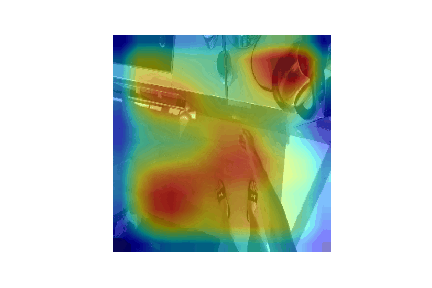

In [59]:
visualize_spat_attn_video(model, seq_path, 4, 0, func, seq_name, model_info='{}_{}_{}_{}'.format(dataset, model_name, exp, epoch))

t:   2%|▏         | 2/121 [00:00<00:06, 17.15it/s, now=None]

MoviePy - Building file /mnt/4TB/aaron/mlcv-exp/data/saved/P20_P20_03_21943_open_drawer_0_14_fpha_hpo_bbox_ar_SL_exp1_200.gif with imageio.


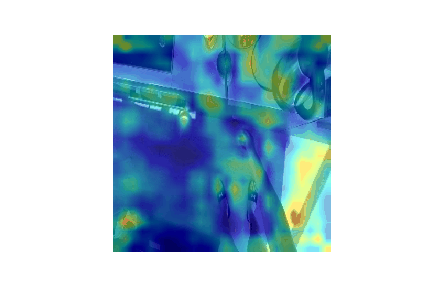

In [60]:
visualize_spat_attn_video(model, seq_path, 0, 14, func, seq_name, model_info='{}_{}_{}_{}'.format(dataset, model_name, exp, epoch))

t:   0%|          | 0/121 [00:00<?, ?it/s, now=None]

MoviePy - Building file /mnt/4TB/aaron/mlcv-exp/data/saved/P20_P20_03_21943_open_drawer_1_4_fpha_hpo_bbox_ar_SL_exp1_200.gif with imageio.


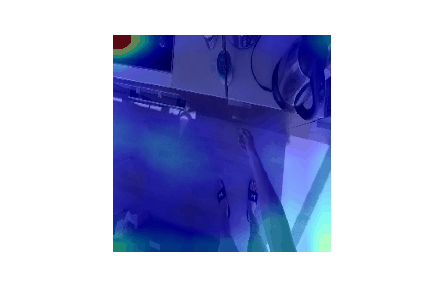

In [61]:
visualize_spat_attn_video(model, seq_path, 1, 4, func, seq_name, model_info='{}_{}_{}_{}'.format(dataset, model_name, exp, epoch))